<a href="https://colab.research.google.com/github/karlacuv/MCD_Procesamiento/blob/main/Tarea5_ProcesamientoImagenes.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Procesamiento de Imágenes
### Karla Cureño Vega - 2085376

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


### Operaciones básicas con Pillow

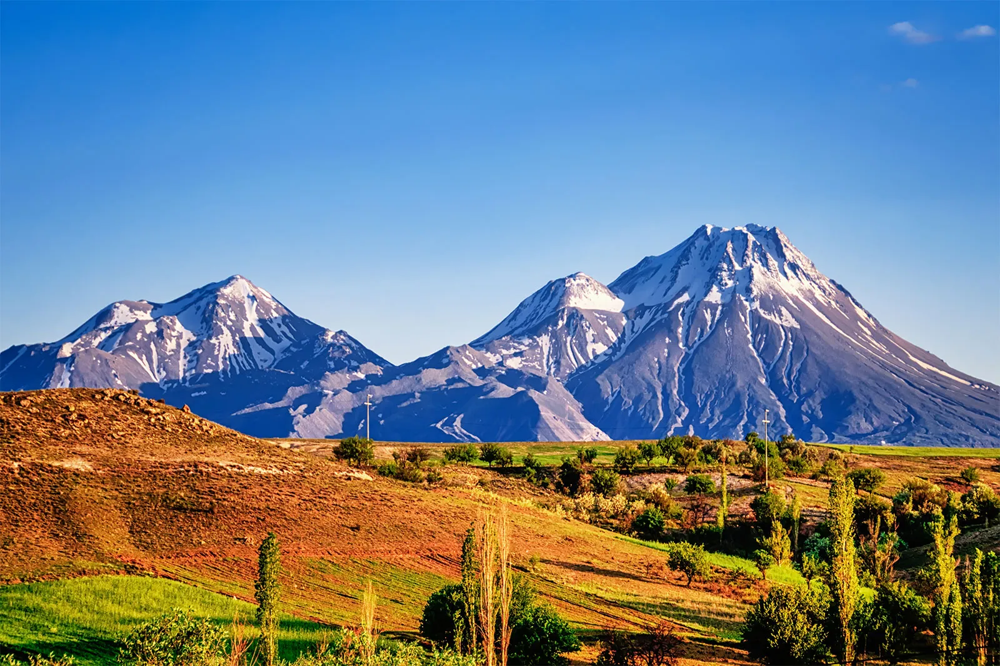

In [279]:
from PIL import Image
filename = "/content/drive/My Drive/Files/MCD/Procesamiento y Clasificación de Datos/Semana 5 - Procesamiento de Imagenes/mountains.jpg"
with Image.open(filename) as img:
    img.load()


type(img)


isinstance(img, Image.Image)

img.show()
img

In [6]:
## Atributos de la imagen
print(img.format)
print(img.size)
print(img.mode)

WEBP
(1600, 1067)
RGB


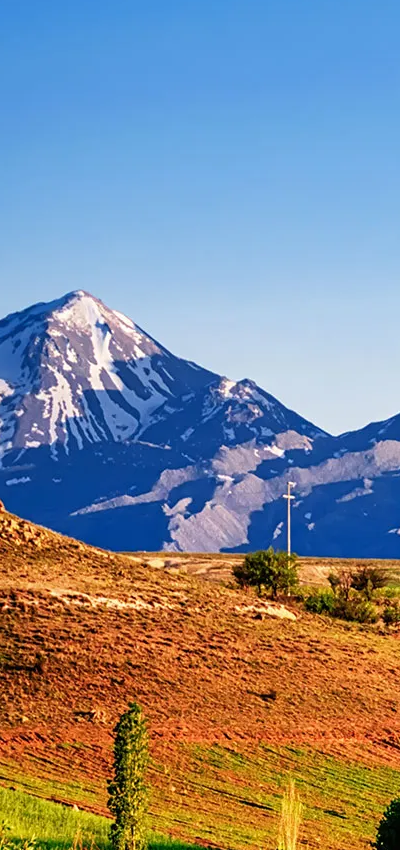

In [8]:
## Cortando imagen
cropped_img = img.crop((300, 150, 700, 1000))
cropped_img.size
cropped_img.show()
cropped_img

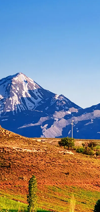

In [10]:
## Cambiando resolución
low_res_img = cropped_img.resize(
    (cropped_img.width // 4, cropped_img.height // 4)
)
low_res_img.show()
low_res_img

In [11]:
## Guardando las imágenes

cropped_img.save("/content/drive/My Drive/Files/MCD/Procesamiento y Clasificación de Datos/Semana 5 - Procesamiento de Imagenes/cropped_image.jpg")
low_res_img.save("/content/drive/My Drive/Files/MCD/Procesamiento y Clasificación de Datos/Semana 5 - Procesamiento de Imagenes/low_resolution_cropped_image.png")

### Manipulación básica de imágenes

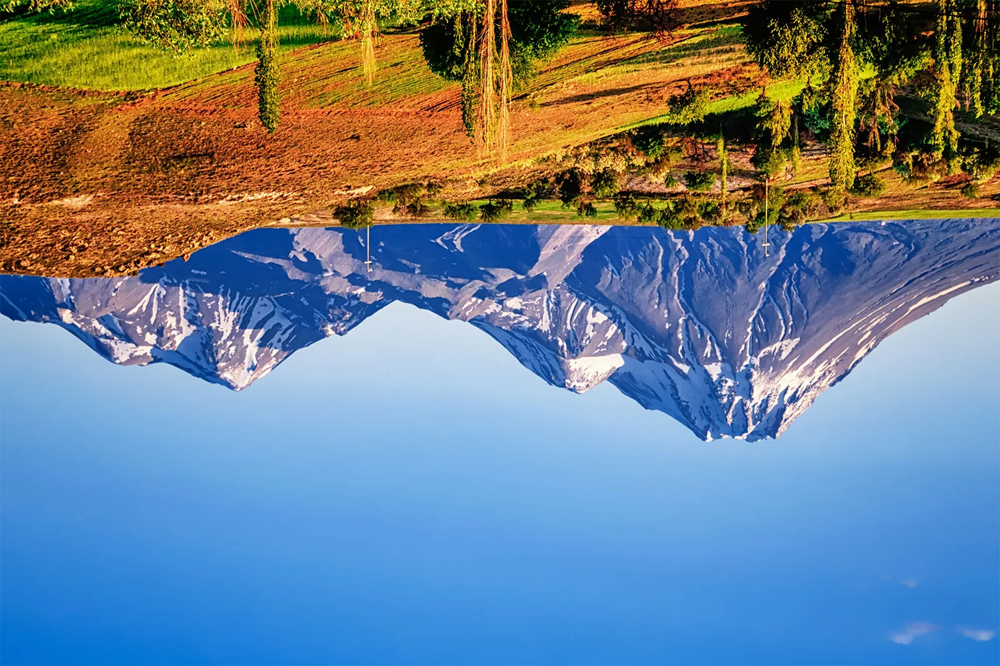

In [12]:
## Transpose
converted_img = img.transpose(Image.FLIP_TOP_BOTTOM)
converted_img

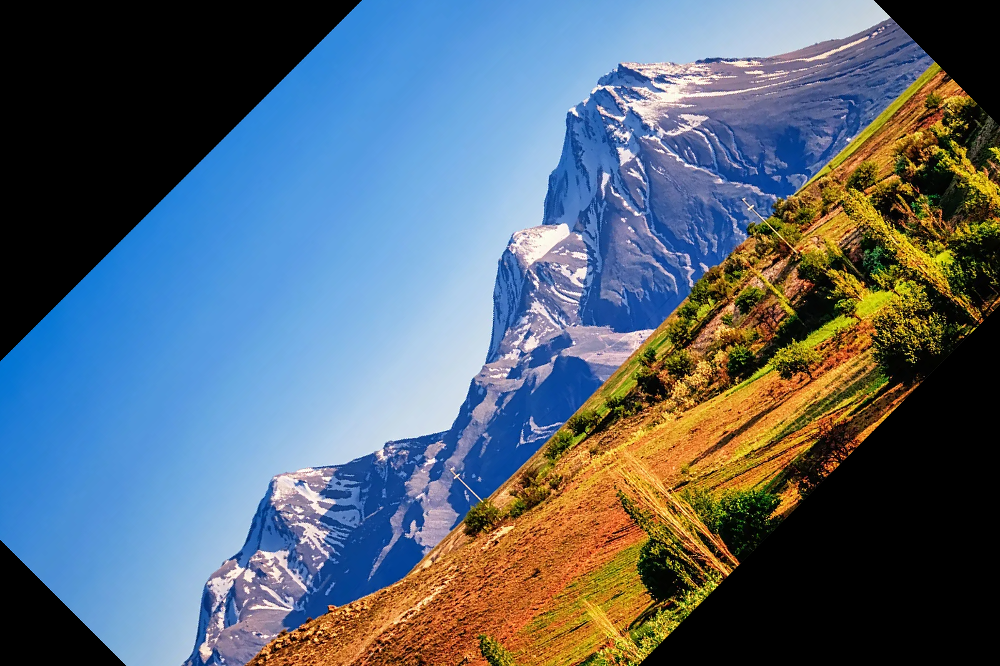

In [14]:
## Rotación
rotated_img = img.rotate(45)
rotated_img

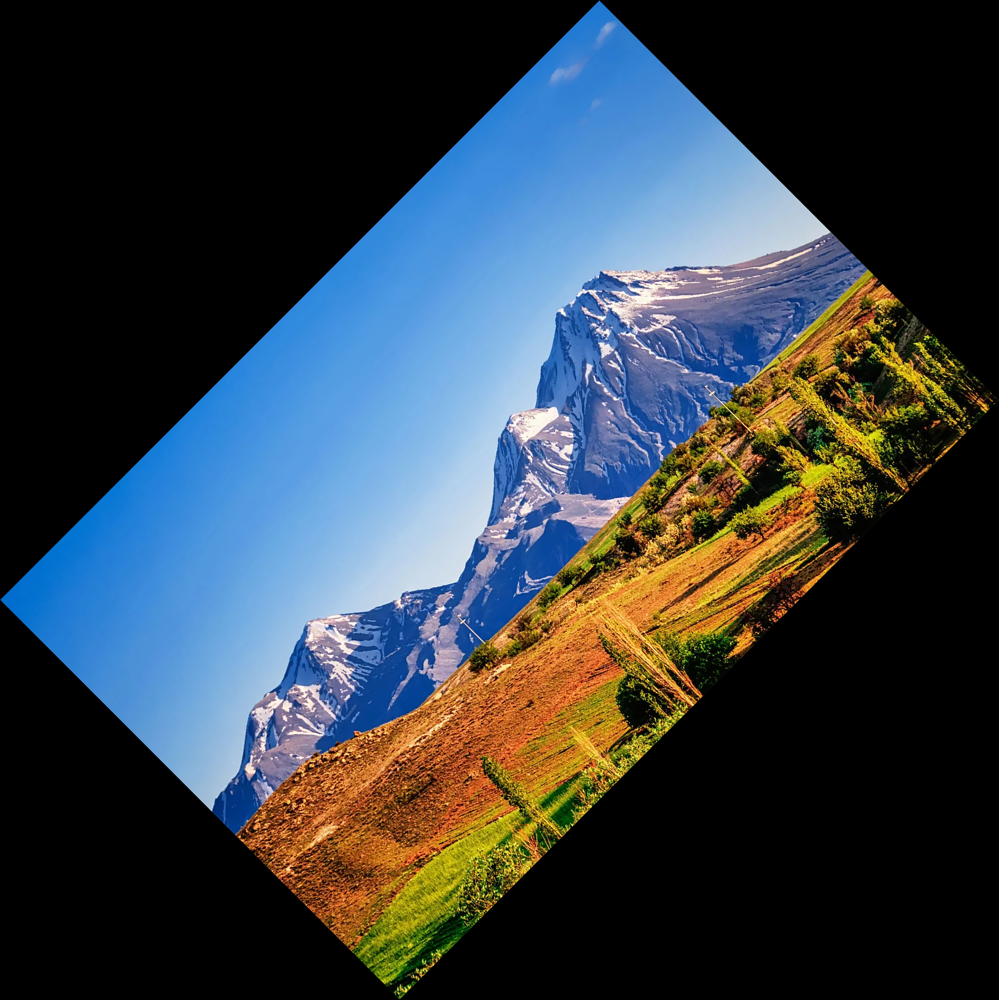

In [16]:
## Rotación sin cortar bordes
rotated_img = img.rotate(45, expand=True)
rotated_img

### Diferentes modos de imagen

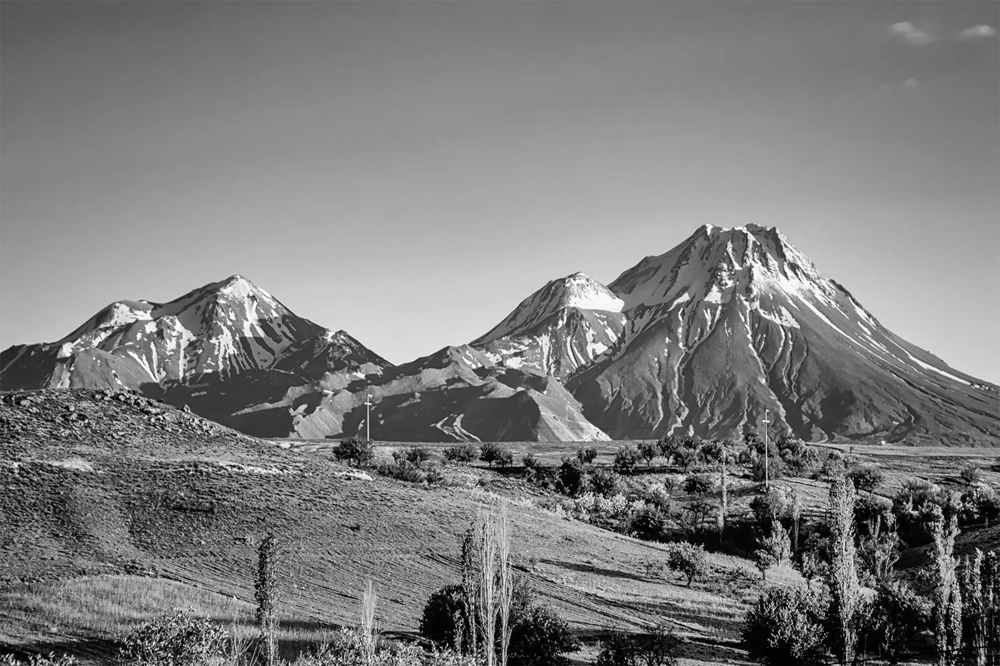

In [18]:
cmyk_img = img.convert("CMYK")
gray_img = img.convert("L")  # Grayscale


gray_img

In [19]:
##Obteniendo bandas de diferentes modos de imagen
print(img.getbands())

print(cmyk_img.getbands())

print(gray_img.getbands())

('R', 'G', 'B')
('C', 'M', 'Y', 'K')
('L',)


In [20]:
#Separando imagen en bandas
red, green, blue = img.split()
red

print(red.mode)

L


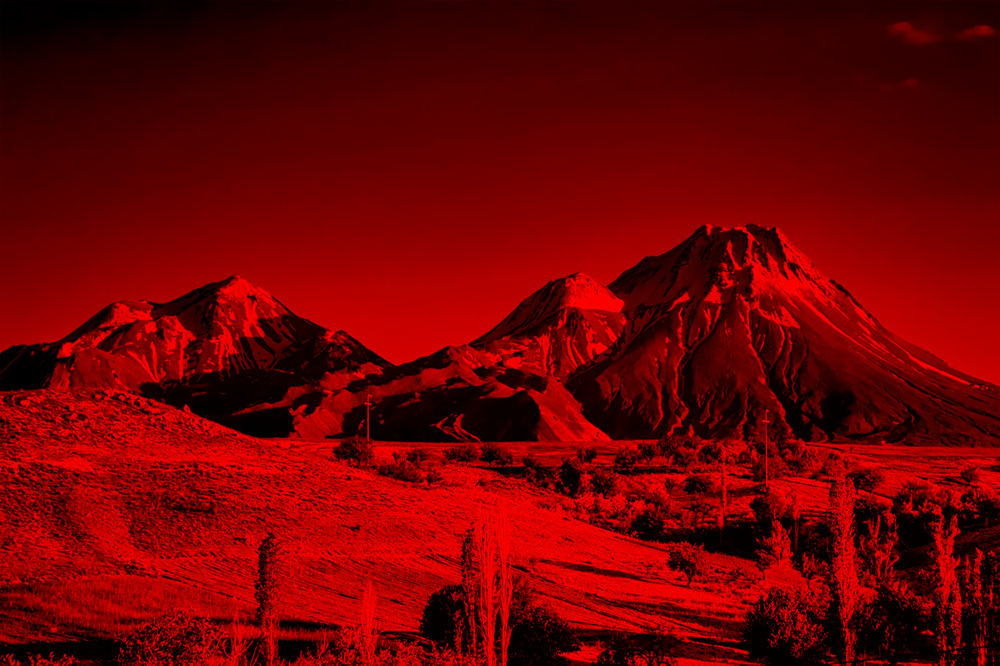

In [21]:
zeroed_band = red.point(lambda _: 0)

red_merge = Image.merge(
    "RGB", (red, zeroed_band, zeroed_band)
)

green_merge = Image.merge(
    "RGB", (zeroed_band, green, zeroed_band)
)

blue_merge = Image.merge(
    "RGB", (zeroed_band, zeroed_band, blue)
)

red_merge

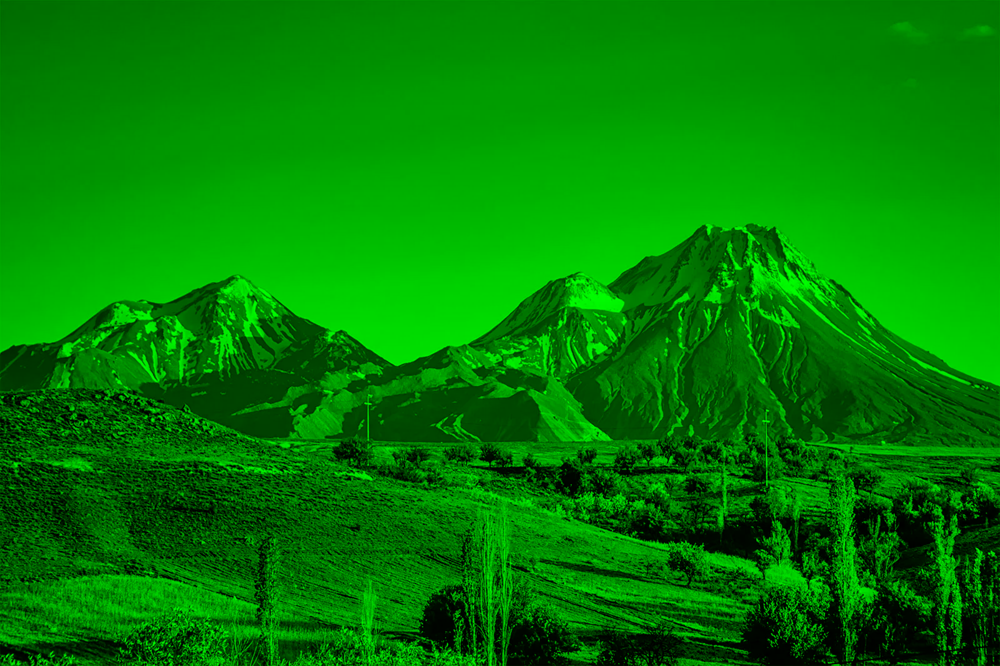

In [22]:
green_merge

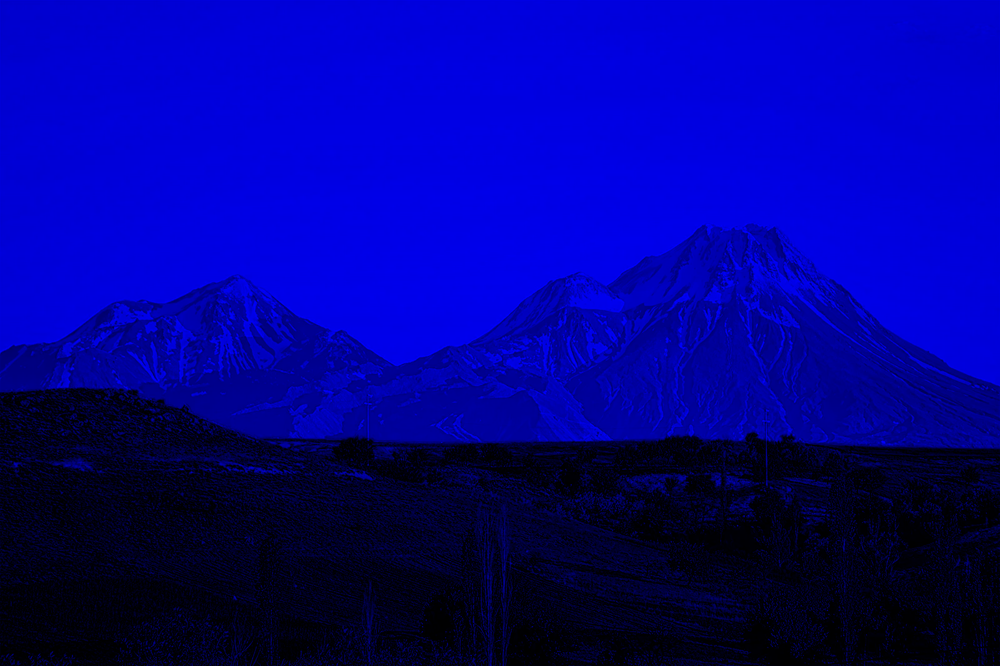

In [23]:
blue_merge

### Filtros usando Kernels Convolucionales

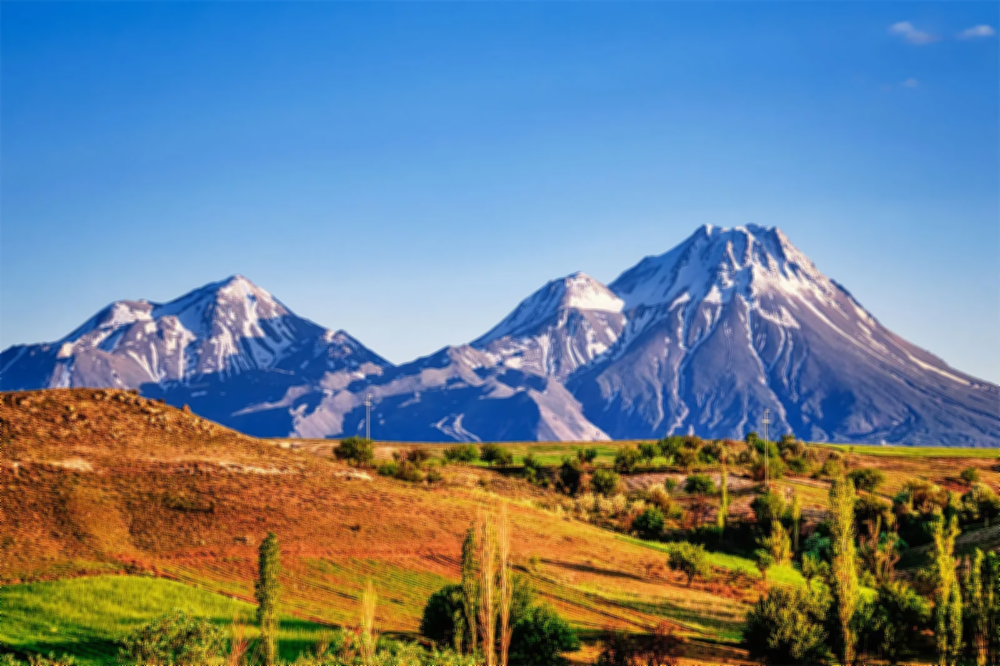

In [30]:
## Blur
from PIL import Image, ImageFilter
blur_img = img.filter(ImageFilter.BLUR)
blur_img

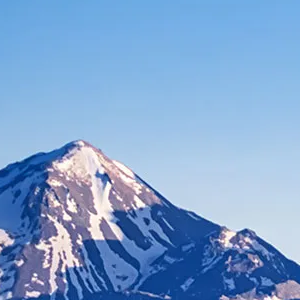

In [34]:
## Cropped image
img.crop((300, 300, 600, 600))

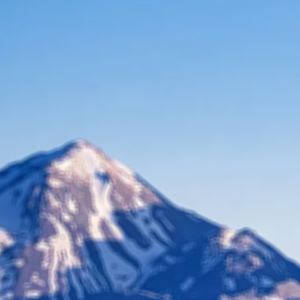

In [35]:
## Blurred cropped image
blur_img.crop((300, 300, 600, 600))

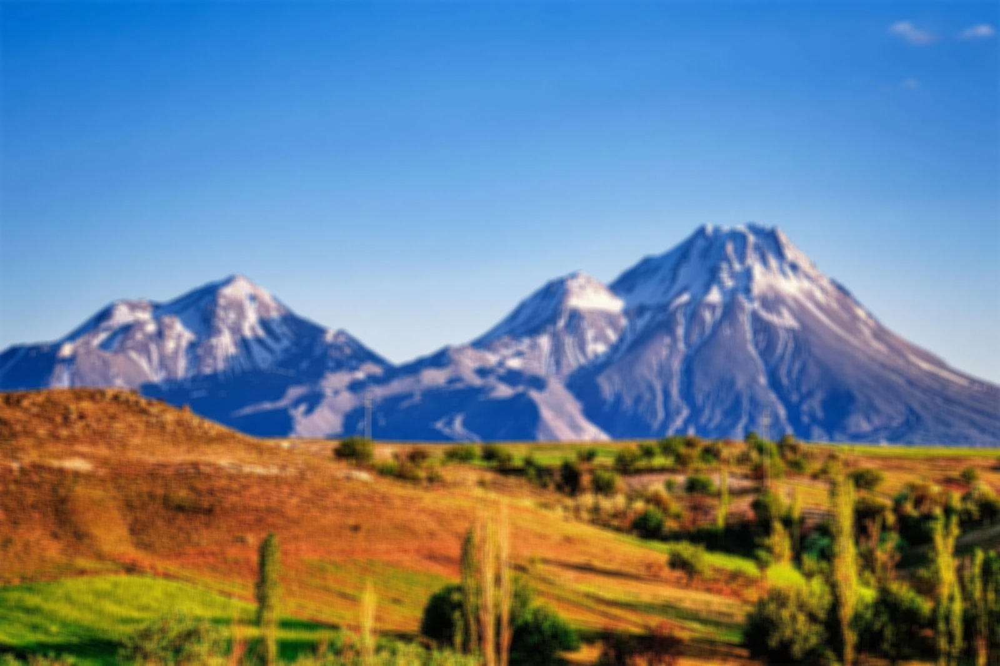

In [36]:
#Diferentes tipos de Blur
img.filter(ImageFilter.BoxBlur(5))

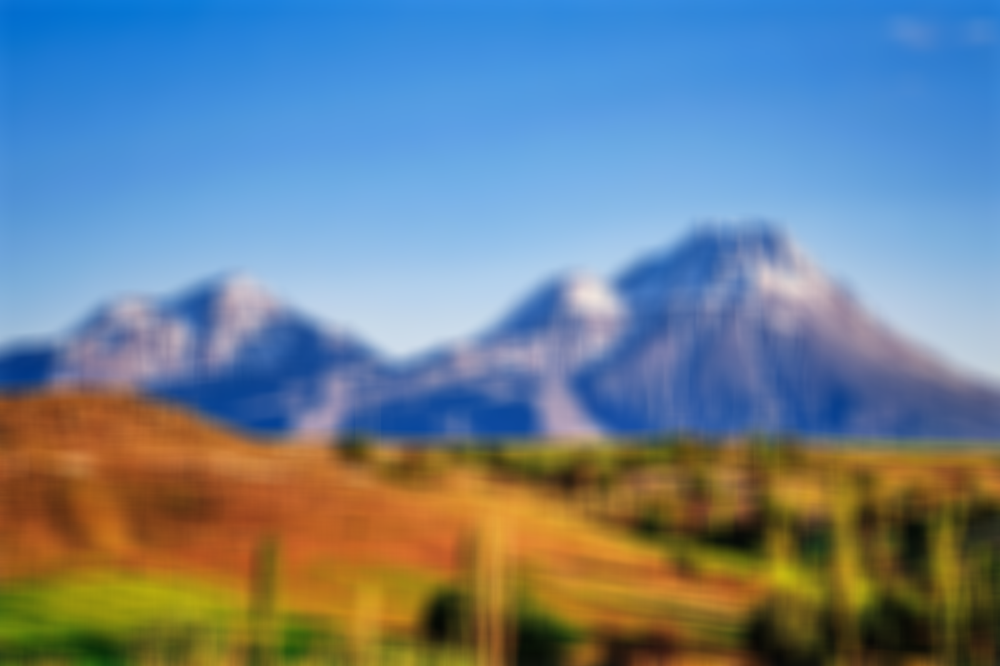

In [38]:
#Diferentes tipos de Blur
img.filter(ImageFilter.BoxBlur(20))

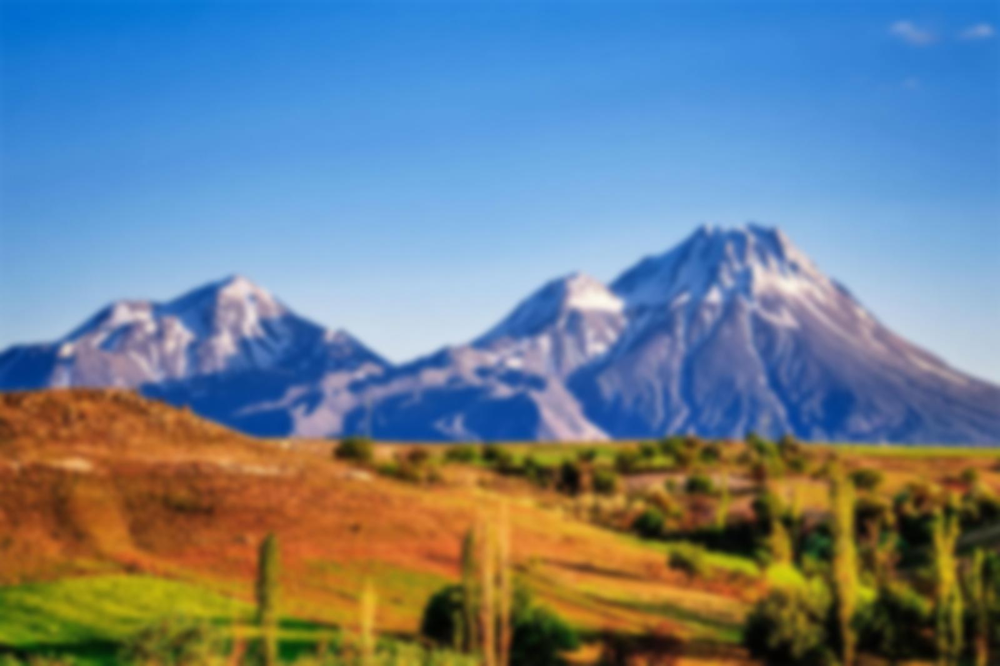

In [39]:
#Diferentes tipos de Blur
img.filter(ImageFilter.GaussianBlur(5))

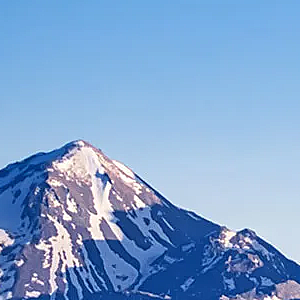

In [42]:
## Sharpen
sharp_img = img.filter(ImageFilter.SHARPEN)
sharp_img.crop((300, 300, 600, 600))

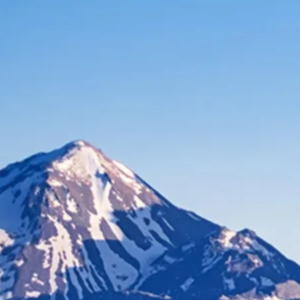

In [43]:
## Smooth
smooth_img = img.filter(ImageFilter.SMOOTH)
smooth_img.crop((300, 300, 600, 600))

### Detección de bordes, mejora de bordes y embossing

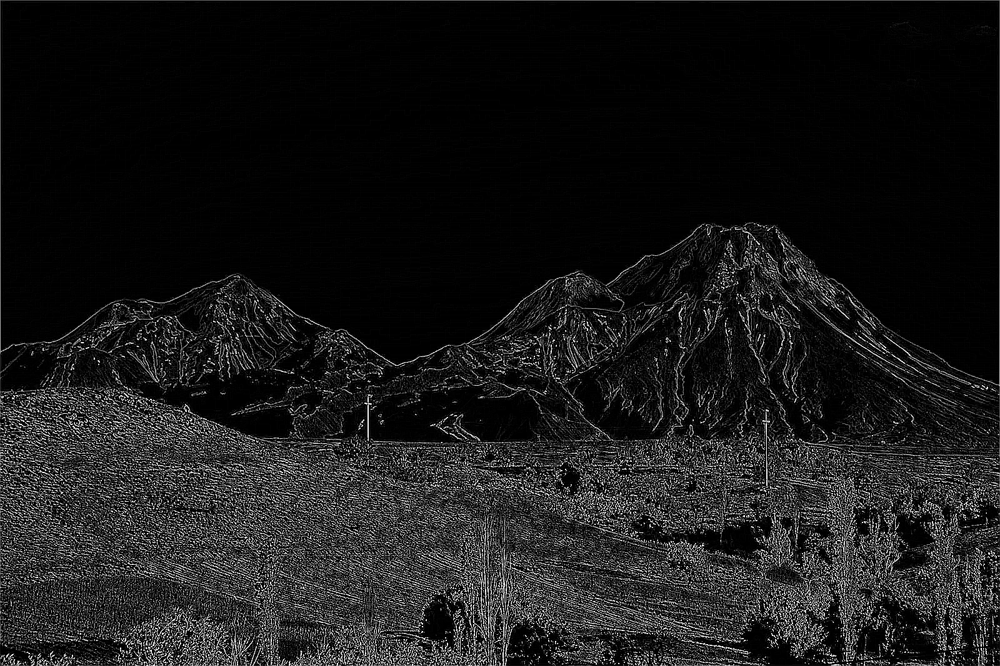

In [44]:
## Detección de bordes
img_gray = img.convert("L")
edges = img_gray.filter(ImageFilter.FIND_EDGES)
edges

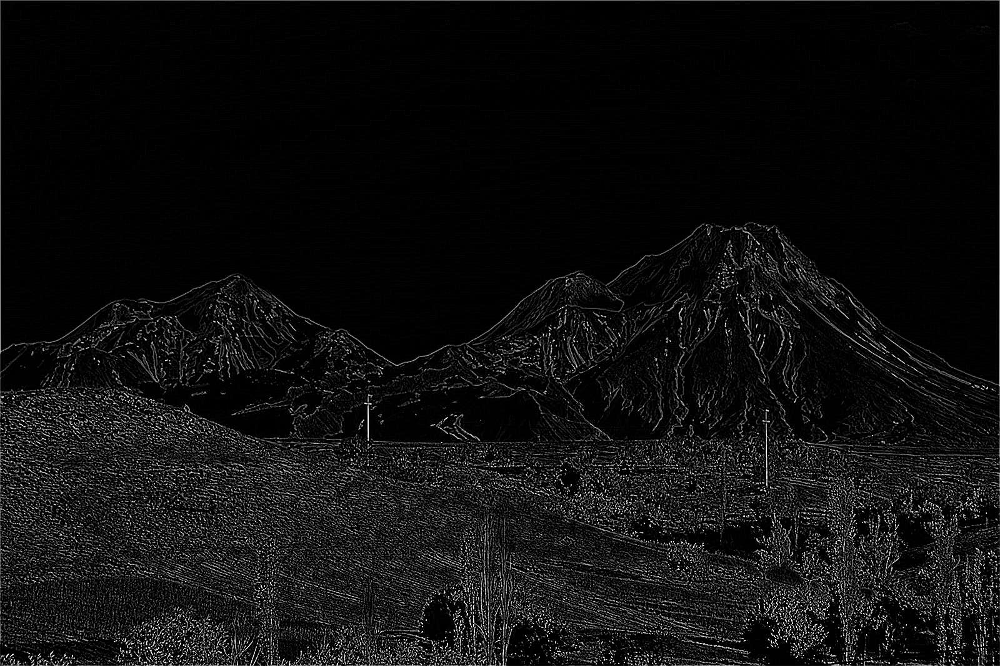

In [45]:
## Detección de bordes después de Smooth

img_gray_smooth = img_gray.filter(ImageFilter.SMOOTH)
edges_smooth = img_gray_smooth.filter(ImageFilter.FIND_EDGES)
edges_smooth

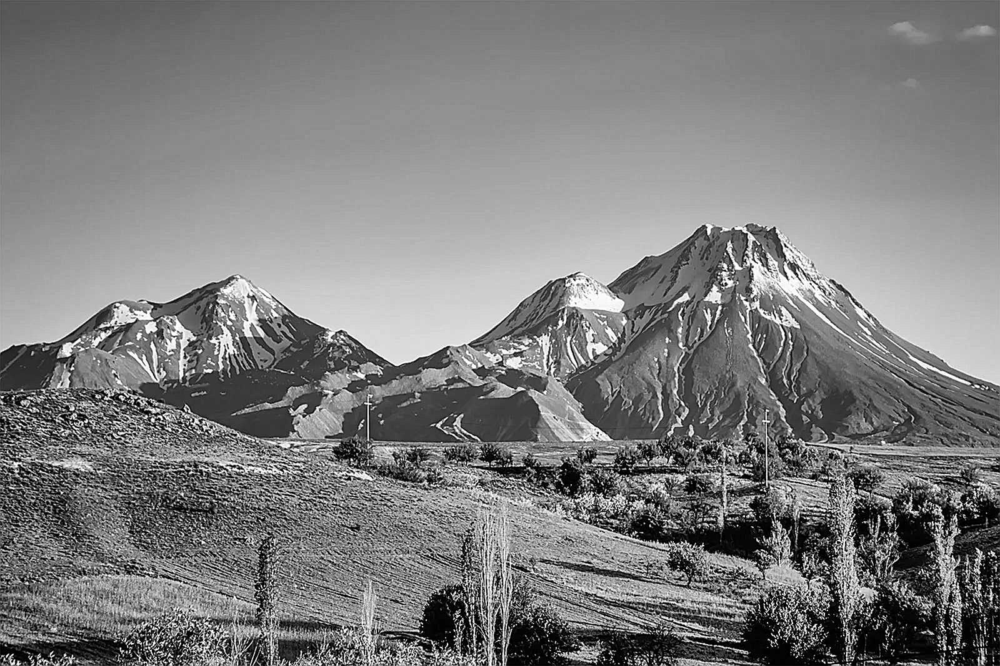

In [46]:
## Mejora de bordes
edge_enhance = img_gray_smooth.filter(ImageFilter.EDGE_ENHANCE)
edge_enhance

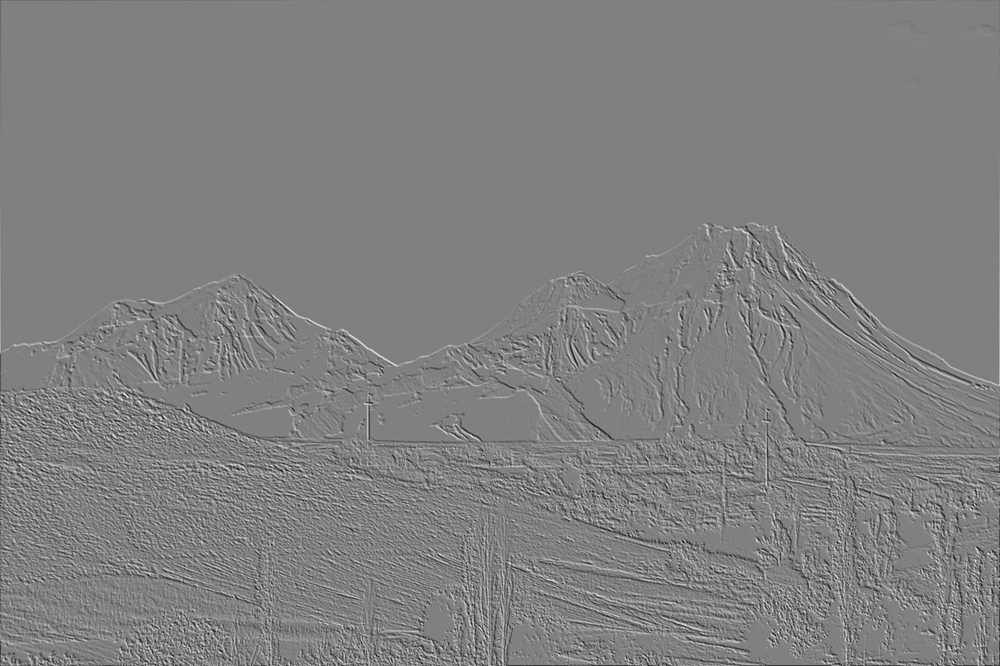

In [47]:
## Emboss
emboss = img_gray_smooth.filter(ImageFilter.EMBOSS)
emboss

### Segmentación de imágenes y superposición

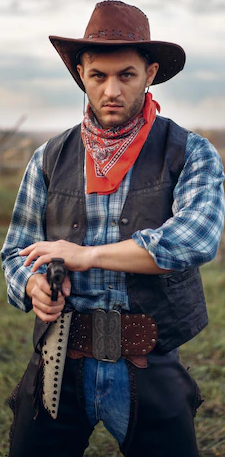

In [193]:
from PIL import Image
filename_cowboy = "/content/drive/My Drive/Files/MCD/Procesamiento y Clasificación de Datos/Semana 5 - Procesamiento de Imagenes/cowboy.jpg"

with Image.open(filename_cowboy) as img_cowboy:
    img_cowboy.load()


img_cowboy=img_cowboy.crop((225,37,450,494)).convert("RGB")
img_cowboy

In [113]:
print(img_cowboy.size)

(225, 457)


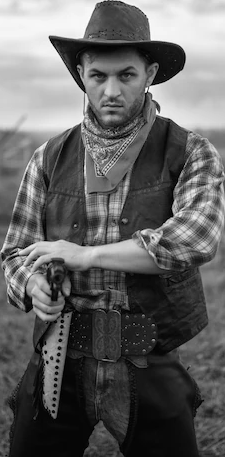

In [114]:
# Grayscale
img_cowboy_gray = img_cowboy.convert("L")
img_cowboy_gray

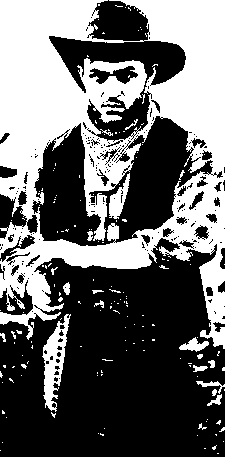

In [115]:
## Tresholding
threshold = 100
img_cowboy_threshold = img_cowboy_gray.point(
    lambda x: 255 if x > threshold else 0
)
img_cowboy_threshold

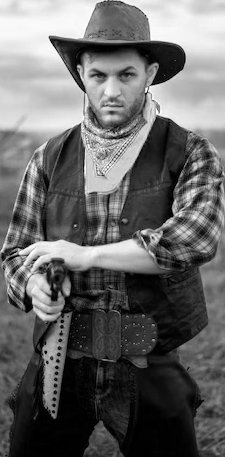

In [116]:
## Diviendo en bandas de color

red, green, blue = img_cowboy.split()
red

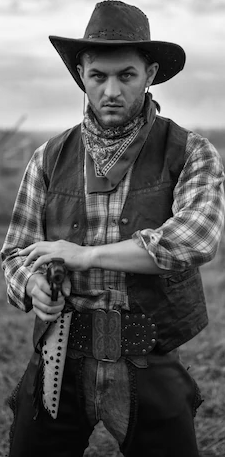

In [117]:
green

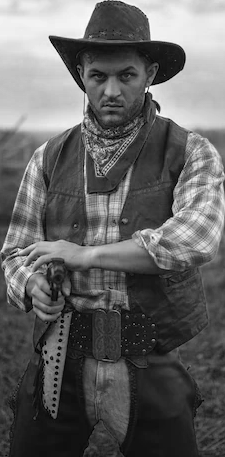

In [130]:
blue

In [158]:
## En azul hay más contraste, se puede usar para hacer el treshold
threshold = 57
img_cowboy_threshold = green.point(lambda x: 255 if x > threshold else 0)
img_cowboy_threshold = img_cowboy_threshold.convert("1")

TypeError: ignored

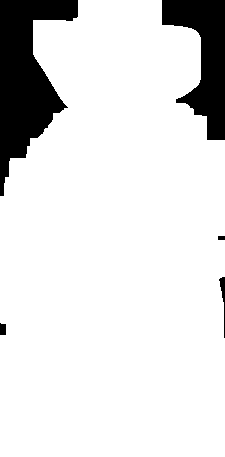

In [191]:
## Segmentación de Imagen con Erosión y Dilatación
from PIL import ImageFilter
import PIL.ImageOps
import cv2

def erode(cycles, image):
    for _ in range(cycles):
         image = image.filter(ImageFilter.MinFilter(3))
    return image


def dilate(cycles, image):
    for _ in range(cycles):
         image = image.filter(ImageFilter.MaxFilter(3))
    return image

step_1 = erode(16, img_cowboy_threshold).convert('RGB')
step_1= PIL.ImageOps.invert(step_1)
step_1

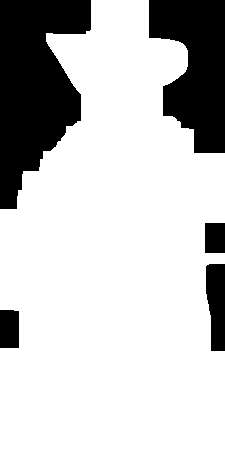

In [247]:
step_2=dilate(-10,step_1)
step_2

cowboy_mask=erode(13,step_2)
cowboy_mask

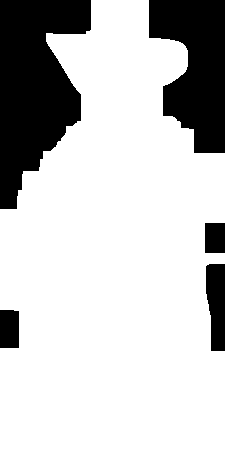

In [248]:
cowboy_mask = cowboy_mask.convert("L")
cowboy_mask = cowboy_mask.filter(ImageFilter.SHARPEN)
cowboy_mask

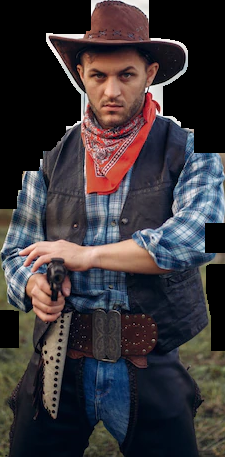

In [249]:
blank = img_cowboy.point(lambda _: 0)
cowboy_segmented = Image.composite(img_cowboy, blank,cowboy_mask)
cowboy_segmented

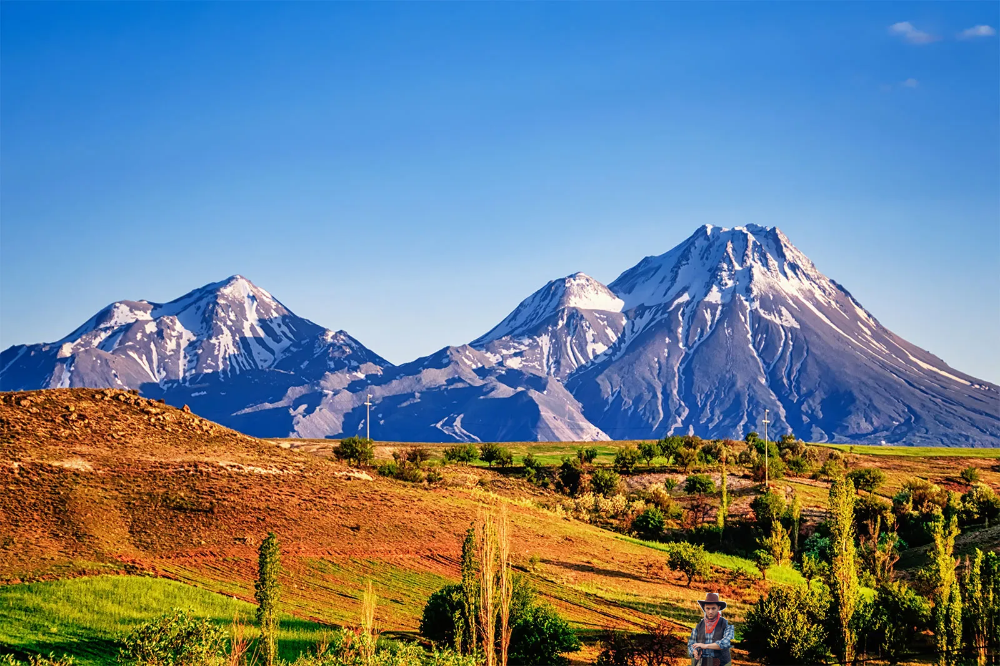

In [280]:
## Superposición de imagenes
img.paste(
    img_cowboy.resize((img_cowboy.width // 3, img_cowboy.height // 3)),
    (1100,950),
    cowboy_mask.resize((cowboy_mask.width // 3, cowboy_mask.height //3)),
)

img

In [282]:
img.save("/content/drive/My Drive/Files/MCD/Procesamiento y Clasificación de Datos/Semana 5 - Procesamiento de Imagenes/mountains_cowboy.jpg")

### Conclusión de Actividad

Con el uso de Pillow se pueden realizar muchas transformaciones para manipular y procesar imágenes. Esta no es la única biblioteca que puede usarse para procesar imágenes en Python, sin embargo, es muy buena para algunas manipulaciones básicas. 

Para continuar investigando sobre ese tema se pueden usar bibliotecas tales como OpenCV y scikit-image. 

## Adicional - Creación de Animaciones Usando Pillow

Vi este tutorial sobre cómo crear animaciones usando Pillow y me pareció interesante así que decidí probarlo.

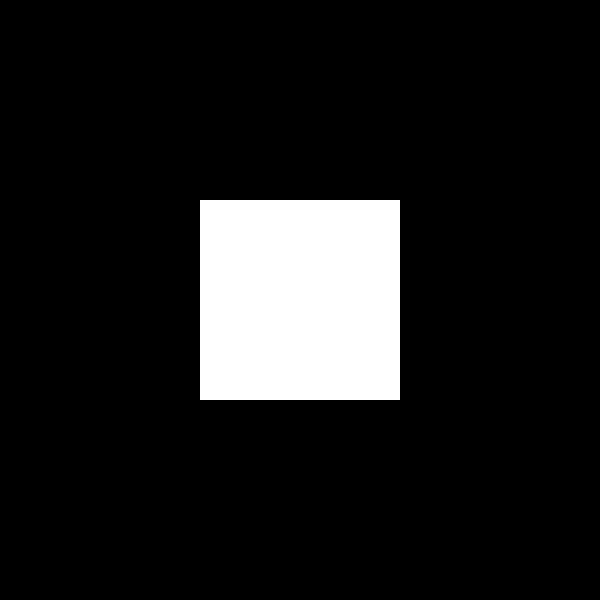

In [285]:
#Creando una imagen usando Pillow y NumPy

import numpy as np
from PIL import Image

square = np.zeros((600, 600))
square[200:400, 200:400] = 255

square_img = Image.fromarray(square).convert("L")
square_img

In [286]:
#Creando cuadrados de diferentes colores
red = np.zeros((600, 600))
green = np.zeros((600, 600))
blue = np.zeros((600, 600))
red[150:350, 150:350] = 255
green[200:400, 200:400] = 255
blue[250:450, 250:450] = 255

red_img = Image.fromarray(red).convert("L")
green_img = Image.fromarray(green).convert("L")
blue_img = Image.fromarray((blue)).convert("L")

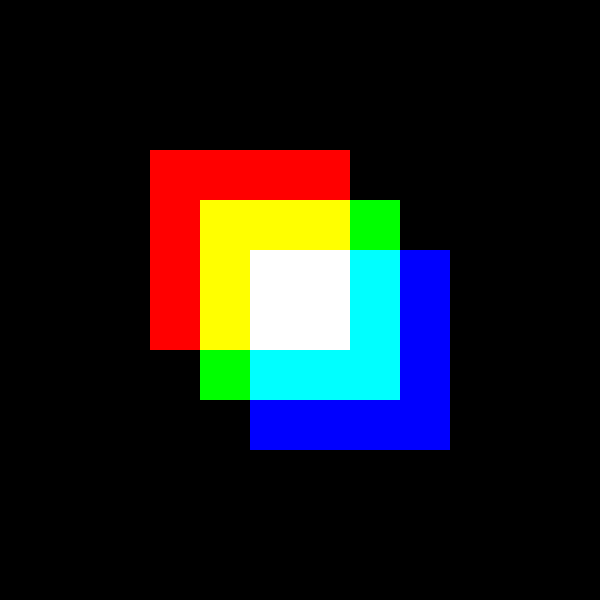

In [287]:
#Combinando los diferentes cuadrados en una sola imagen
square_img = Image.merge("RGB", (red_img, green_img, blue_img))
square_img

In [290]:
#Creando la animación
square_animation = []
for offset in range(0, 100, 2):
    red = np.zeros((600, 600))
    green = np.zeros((600, 600))
    blue = np.zeros((600, 600))
    red[101 + offset : 301 + offset, 101 + offset : 301 + offset] = 255
    green[200:400, 200:400] = 255
    blue[299 - offset : 499 - offset, 299 - offset : 499 - offset] = 255
    red_img = Image.fromarray(red).convert("L")
    green_img = Image.fromarray(green).convert("L")
    blue_img = Image.fromarray((blue)).convert("L")
    square_animation.append(
        Image.merge(
            "RGB",
            (red_img, green_img, blue_img)
        )
    )

#Grabando la animación
square_animation[0].save(
    "/content/drive/My Drive/Files/MCD/Procesamiento y Clasificación de Datos/Semana 5 - Procesamiento de Imagenes/animation.gif", save_all=True, append_images=square_animation[1:]
)